In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import numpy as np
from collections import Counter
import re
import string
import os
from os import path
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

In [3]:
# load dataset
df = pd.read_csv("")

In [15]:
# clean dataset
# remove data that has >280 characters and <15 characters
df = df[df["content"].str.len() <=280]
df = df[df["content"].str.len() >15]

# remove special characters
from nltk.corpus import stopwords as nltkstopwords
stops = set(nltkstopwords.words("english"))
def cleantext(string):
    text = string.lower().split()
    text = " ".join(text)
    text = re.sub(r"http(\S)+",' ',text)    
    text = re.sub(r"www(\S)+",' ',text)
    text = re.sub(r"&",' and ',text)  
    tx = text.replace('&amp',' ')
    text = re.sub(r"[^0-9a-zA-Z]+",' ',text)
    text = text.split()
    text = [w for w in text if not w in stops]
    text = " ".join(text)
    return text

df["content"] = df["content"].apply(cleantext)

shuffledDf = df.sample(frac=1).reset_index(drop=True)
shuffledDf.head(10)

,content,label
0,12 army personnel jakhama army camp quarantine...,1
1,200 close contacts identified two work places ...,1
2,ap nevada gov steve sisolak bars use anti mala...,0
3,government stick 30bn covid bill il fridge,0
4,german intelligence report casts doubts us all...,1
5,70 muslims attended tablighi jamaat event delh...,0
6,independent countries ignore covid inform stre...,0
7,icmr honoured carried testing 2500 samples hon...,1
8,garlic soup cure coronavirus,0
9,pittsburgh pirates players buy 400 pizzas hosp...,1


In [4]:
# df.to_csv("Combined and Cleaned Dataset")

Number of fake news data 11160
Number of real news data 7844


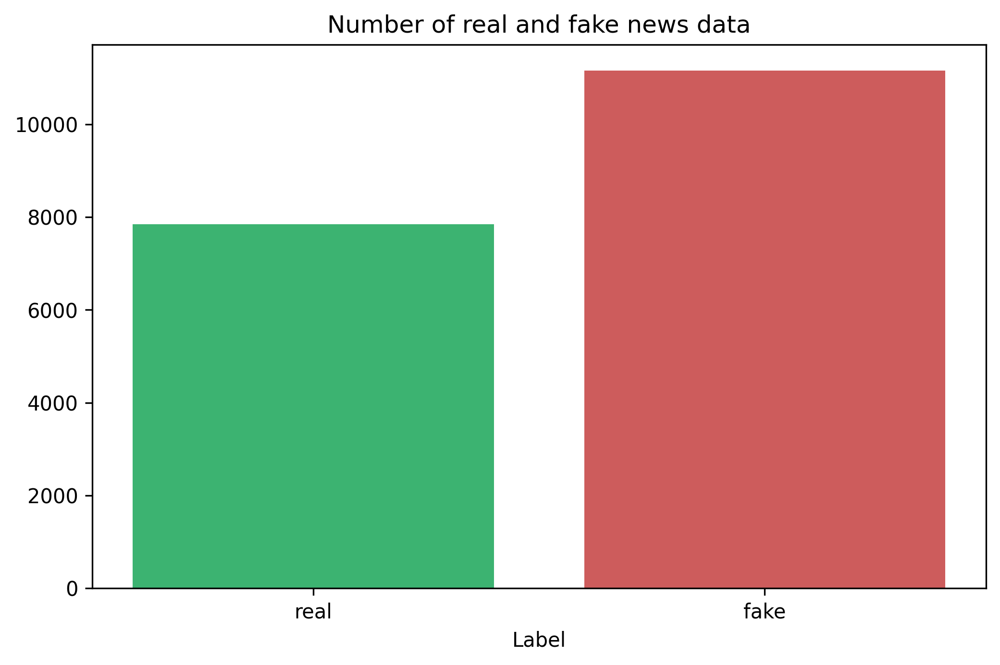

<function matplotlib.pyplot.show(close=None, block=None)>

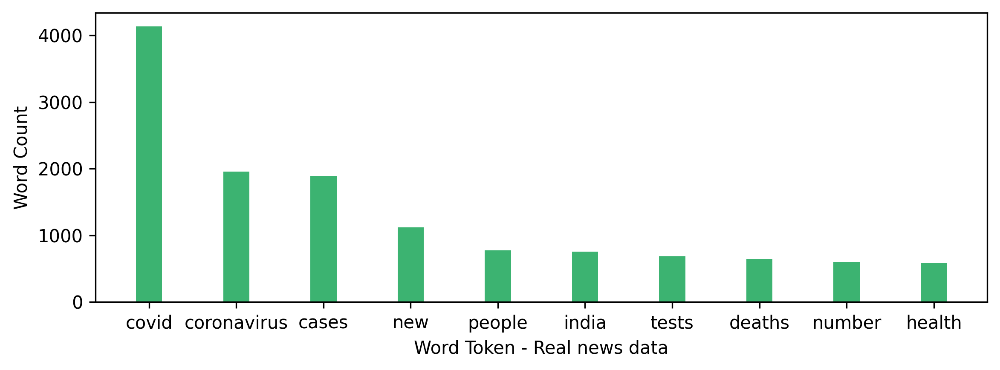

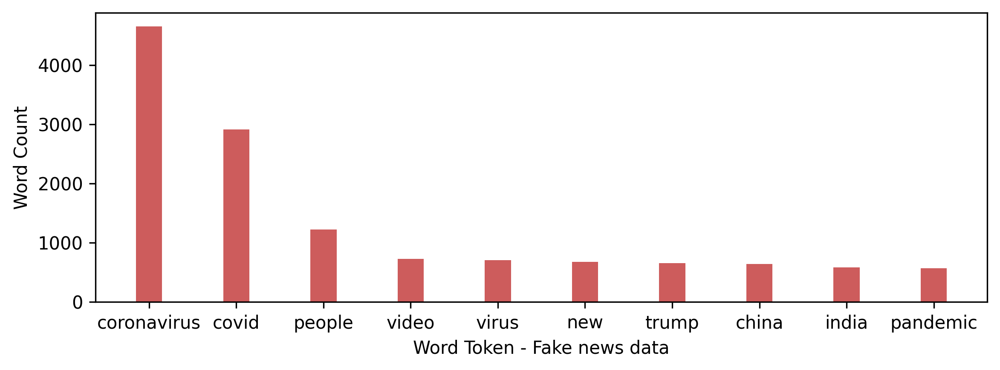

In [19]:
# Analyse Data
allText = df['content']
allTextCombined = ' '.join(allText)

fakeText = df[df.label == 0]
print("Number of fake news data", fakeText.shape[0])
fakeTextCombined = ' '.join(fakeText["content"])

realText = df[df.label == 1]
print("Number of real news data", realText.shape[0])
realTextCombined = ' '.join(realText["content"])

allTokensWords = [w for w in str(allTextCombined).split() if len(w)>1 and w not in stops]
allWordCount = (Counter(allTokensWords).most_common(10))

fakeTokensWords = [w for w in str(fakeTextCombined).split() if len(w)>1 and w not in stops]
fakeWordCount = (Counter(fakeTokensWords).most_common(10))

realTokensWords = [w for w in str(realTextCombined).split() if len(w)>1 and w not in stops]
realWordCount = (Counter(realTokensWords).most_common(10))

plt.figure(figsize=(8,5))
plt.title("Number of real and fake news data")
plt.xlabel("Label")
plt.bar(["real"],[realText.shape[0]],color="mediumseagreen")
plt.bar(["fake"],[fakeText.shape[0]],color="indianred")
plt.show()

ypos = np.arange(10)
plt.figure(figsize=(9,3))
plt.xticks(ypos, [i[0] for i in realWordCount])
plt.bar(ypos, [i[1] for i in realWordCount], width=0.3, color="mediumseagreen")
plt.xlabel("Word Token - Real news data")
plt.ylabel("Word Count")
plt.show

plt.figure(figsize=(9,3))
plt.xticks(ypos, [i[0] for i in fakeWordCount])
plt.bar(ypos, [i[1] for i in fakeWordCount], width=0.3, color="indianred")
plt.xlabel("Word Token - Fake news data")
plt.ylabel("Word Count")
plt.show




In [ ]:
# stops for word cloud visualisation
stops = stops.union({'pic','co','com','covid19','19','u','twitter'})

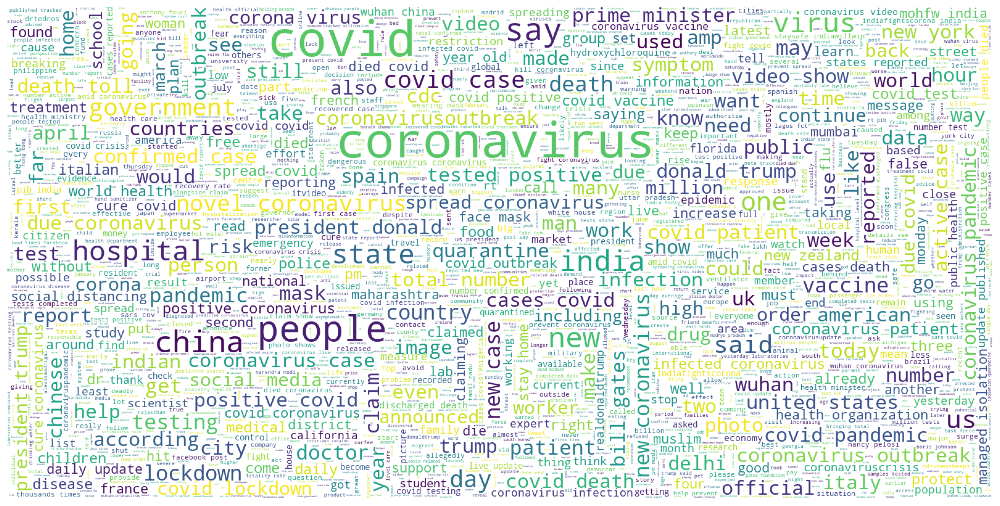

In [14]:
# wordcloud generation
wordcloud1 = WordCloud(background_color="white", max_words = 2000 , width = 1600 , height = 800,
               stopwords=stops, max_font_size=80, random_state=42).generate(str(allTextCombined))
plt.figure(figsize=(20,20))
plt.imshow(wordcloud1)
plt.axis("off")
plt.show()

(-0.5, 3029.5, 1090.5, -0.5)

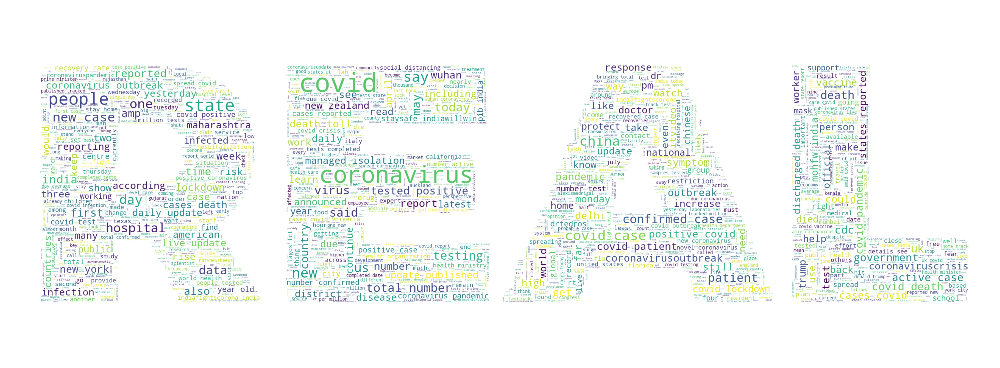

In [11]:
corpus_str = str(realTextCombined)

d = path.dirname(__file__) if "__file__" in locals() else os.getcwd()

# read the mask / color image taken from
coloring = np.array(Image.open(path.join(d, "real_news.jpg")))
#stopwords = set(STOPWORDS)

wc = WordCloud(background_color="white", max_words = 2000 , width = 1600 , height = 800, mask=coloring,
               stopwords=stops, max_font_size=80, random_state=42)

# generate word cloud
wc.generate(corpus_str)

# create coloring from image
image_colors = ImageColorGenerator(coloring)
plt.figure(figsize = (20,20))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")


(-0.5, 3029.5, 1090.5, -0.5)

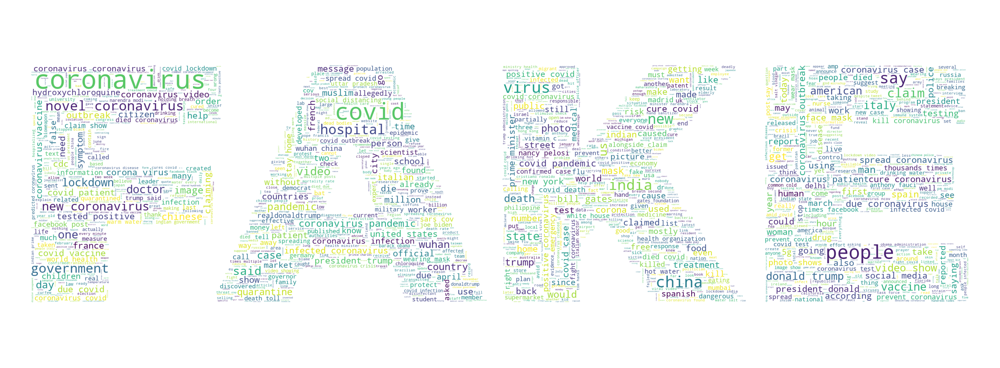

In [12]:
corpus_str = str(fakeTextCombined)

d = path.dirname(__file__) if "__file__" in locals() else os.getcwd()

# read the mask / color image taken from
coloring = np.array(Image.open(path.join(d, "fake_news.jpg")))
#stopwords = set(STOPWORDS)

wc = WordCloud(background_color="white", max_words = 2000 , width = 1600 , height = 800, mask=coloring,
               stopwords=stops, max_font_size=80, random_state=42)

# generate word cloud
wc.generate(corpus_str)

# create coloring from image
image_colors = ImageColorGenerator(coloring)
plt.figure(figsize = (20,20))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
